In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
!env | grep PYTHONPATH

In [3]:
import numpy as np
import matplotlib.pylab as plt
import detectron2
import cv2
import os
import pathlib
import json
import random
from PIL import Image, ImageDraw, ImageDraw2
import pandas as pd
import torchvision
from torchvision import transforms
import torch
import shutil
import glob

In [4]:
from detectron2.utils.logger import setup_logger
from detectron2 import model_zoo
from detectron2.engine import DefaultTrainer, DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.structures import BoxMode
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_train_loader, build_detection_test_loader

# LOG

Datasets:

1. 128 image RGB -> rhlogo (DONE)
2. 128 image grayscale -> rhlogo_gray (DONE)
3. 1280 image RGB -> rhlogo_expanded (DONE)
4. 1280 image grayscale (DONE)
5. 128 image diverse backgrounds (DONE)
6. 128 image logo (with bbox augmentations) (DONE)

1. Same dataset + further training (2000 iterations) leads to better performance

Example images indicate color might be a problem i.e. red patches identified as red hat logo.
2. Increase size of dataset

2. Grayscale data (existing images converted to grayscale)

3. Diverse backgrounds

4. Only logos but with more transforms (will need bbox augmentations)

# Dataset Generation

In [5]:
def generate_background_image(color_center, color_edge, size=(512,512), generate=True, bkg_loc=None):
    if not generate:
        if bkg_loc is None:
            raise ValueError('Please pass bkg_loc if generate is False')
        img = retrieve_background_image(bkg_loc).resize(size)
        return img
    
    #distance calculation
    row_idx = np.repeat(np.arange(0, size[0]), size[1], axis=0).reshape(size)
    col_idx = np.repeat(np.arange(0, size[1]), size[0], axis=0).reshape((size[1], size[0])).T    
    
    center = (size[0]/2, size[1]/2)
    dist = np.zeros(size)
    dist = np.sqrt((row_idx - center[0])**2 + (col_idx - center[1])**2)
    max_dist = np.max(dist)
    dist /= max_dist    
    
    #colors
    r = color_edge[0] * dist + color_center[0] * (1-dist)
    g = color_edge[1] * dist + color_center[1] * (1-dist)
    b = color_edge[2] * dist + color_center[2] * (1-dist)    
    
    #check artifacts with Image.fromarray()
    img = Image.new('RGBA', size)
    for y in range(size[1]):
        for x in range(size[0]):
            img.putpixel((x,y), (int(r[x,y]), int(g[x,y]), int(b[x,y])))
    
    return img

def retrieve_background_image(LOC):
    bkg_files = glob.glob(f'{LOC}/*.jpg')
    
    img_filename = np.random.choice(bkg_files)
    
    img = Image.open(img_filename).convert('RGBA')

    return img

def make_logo_transparent(logo, threshold_color=[200,200,200]):
    logo = logo.convert('RGBA')
    data = logo.getdata()
    
    data_alpha = []
    for pixel in data:
        #if pixel[0]>200 and pixel[1]>200 and pixel[2]>200:
        if pixel[0]>threshold_color[0] and pixel[1] > threshold_color[1] and pixel[2] > threshold_color[2]:
            data_alpha.append((pixel[0], pixel[1], pixel[2], 0))
            #data_alpha.append((0,255,0,0))
        else:
            data_alpha.append((pixel[0], pixel[1], pixel[2], pixel[3]))
        
    logo.putdata(data_alpha)
    
    return logo

In [6]:
def generate_augmented_image(size=(512,512),
                             logo_file='CLOUDERALOGO.jpg',
                             N_tfms_to_apply=2,
                             low_frac=0.30,
                             high_frac=0.90,
                             grayscale=False,
                             generate=True,
                             bkg_loc=None,
                             perspective_tfm=False):
        
    logo = Image.open(logo_file) #inefficient to open N times but okay for now

    #logo
    #step 1: get resize parameters
    frac0 = (np.random.random()*(high_frac-low_frac) + low_frac)
    frac1 = (np.random.random()*(high_frac-low_frac) + low_frac)
    #logo_size = (int(frac0*size[0]), int(frac1*size[1]))
    
    aspect_ratio_distort = np.random.random()*0.2 + 0.9 #0.9*1.1
    logo_size = (int(aspect_ratio_distort*frac0*size[0]), int(aspect_ratio_distort*frac0*size[1])) #keep aspect ratio

    #logo_size = (128,128) #introduce some randomness

    #step 2: get mask and apply resizing
    logo = make_logo_transparent(logo)
    logo = logo.resize(logo_size)

    if perspective_tfm:
        logo = transforms.RandomPerspective(distortion_scale=0.7)(logo)
    
    #step 3: apply transformations
    tfms_list = [                
                    transforms.RandomRotation(45, expand=False, fill=255),
                    #transforms.RandomAffine(0, translate=(0.3,0.3)), #for truncations
                    transforms.RandomAffine(0, shear=10)
                ]

    N_tfms = len(tfms_list)

    logo_tfms = logo.copy()
    for i in range(N_tfms_to_apply): #apply N transformations
        logo_tfms = tfms_list[np.random.randint(N_tfms)](logo_tfms)
        #logo_tfms = make_logo_transparent(logo_tfms)

    logo_tfms = make_logo_transparent(logo_tfms)

    #step 4: background image 
    colors = [(255,0,0), (0,255,0), (0,0,255), (128,0,0), (0,128,0), (0,0,128), 
              (0,0,0), (255,255,255), (128,128,128),        
              (255,255,0), (255,0,255), (0,255,255), (128,128,0), (128,0,128), (0,128,128)]
    N_colors = len(colors)

    colors_picked = np.array(colors)[np.random.randint(0, N_colors, size=2)]

    bkg = generate_background_image(colors_picked[0], colors_picked[1], size=size, generate=generate, bkg_loc=bkg_loc)

    #step 5: superimpose at random locations (actual translations)
    location_x = [0, bkg.size[0]-logo.size[0]]
    location_y = [0, bkg.size[1]-logo.size[1]]

    loc = (np.random.randint(*location_x), np.random.randint(*location_y))

    bkg.paste(logo_tfms, loc, logo_tfms)
    
    if grayscale:
        bkg = transforms.Grayscale(num_output_channels=3)(bkg)
        #bkg = bkg.convert('LA')
        
    return bkg, (*size, *loc, loc[0] + logo_size[0], loc[1] + logo_size[1])

In [7]:
def visualize_bbox(img, bbox):
    img_copy = img.copy()
    draw = ImageDraw.Draw(img_copy)
    
    draw.rectangle([(bbox[2],bbox[3]), (bbox[4],bbox[5])], outline=128)
    
    return img_copy

In [8]:
def generate_random_string(N=6):
    return ''.join([chr(i) for i in np.random.randint(97,122,size=N)])

def generate_augmented_dataset(N_images,
                               size=(512,512),
                               low_frac=0.30,
                               high_frac=0.90,
                               logo_file='CLOUDERALOGO.jpg',
                               N_tfms_to_apply=2,
                               seed=None,
                               save_loc=None,
                               logo_name=None,
                               generate=True,
                               bkg_loc=None,
                               perspective_tfm=False):
    
    if seed is not None: #should really figure out all torch seeds
        np.random.seed(seed)
        torch.backends.cudnn.deterministic = True
        torch.manual_seed(seed)
        torch.cuda.manual_seed(seed)    
    else:
        torch.backends.cudnn.deterministic = False
    
    img_list, bbox_list = [], []
    for i in range(N_images):
        img, bbox = generate_augmented_image(size, 
                                             logo_file, 
                                             N_tfms_to_apply,
                                             low_frac=low_frac,
                                             high_frac=high_frac,
                                             generate=generate,
                                             bkg_loc=bkg_loc,
                                             perspective_tfm=perspective_tfm)
        img_list.append(img)
        bbox_list.append(bbox)
        
    if save_loc is not None:
        if not os.path.exists(save_loc):
            pathlib.Path(save_loc).mkdir(parents=True, exist_ok=True)
        if logo_name is None:
            raise ValueError("Please enter logo_name if saving images")
                
        csv_fields = {'filename': [],
                      'width': [],
                      'height': [],
                      'class': [],
                      'xmin': [],
                      'ymin': [],
                      'xmax': [],
                      'ymax': []}
                
        for img, bbox in zip(img_list, bbox_list):
            img_name = f'{logo_name}_{generate_random_string()}.png'
            img.save(os.path.join(save_loc, img_name))
            
            csv_fields['filename'].append(os.path.join(save_loc, img_name))
            csv_fields['width'].append(bbox[0])
            csv_fields['height'].append(bbox[1])
            csv_fields['class'].append(logo_name)
            csv_fields['xmin'].append(bbox[2])
            csv_fields['ymin'].append(bbox[3])
            csv_fields['xmax'].append(bbox[4])
            csv_fields['ymax'].append(bbox[5])
            
        pd.DataFrame(csv_fields).to_csv(os.path.join(save_loc, f'{logo_name}.csv'), index=False)
    else:
        csv_fields = None
        
    return img_list, bbox_list, csv_fields

def convert_to_grayscale(color_loc, gray_loc):
    tfm = transforms.Grayscale(num_output_channels=3)
    
    if not os.path.exists(gray_loc):
        pathlib.Path(gray_loc).mkdir(parents=True, exist_ok=True)
        
    for img_file in glob.glob(os.path.join(color_loc, '*.png')):
        filename = img_file.split('/')[-1]
        
        img = Image.open(img_file).convert('LA')        
        img.save(os.path.join(gray_loc, filename))
        
    shutil.copy2(os.path.join(color_loc, 'rhlogo.csv'), os.path.join(gray_loc, 'rhlogo.csv'))
    shutil.copy2(os.path.join(color_loc, 'data.json'), os.path.join(gray_loc, 'data.json'))

### 128 images + color

In [ ]:
if True: #color
    img_list, bbox_list, csv_fields = generate_augmented_dataset(128, 
                                                                 low_frac=0.01,
                                                                 high_frac=0.60,
                                                                 logo_file='RHLOGO.jpg',
                                                                 N_tfms_to_apply=1,
                                                                 save_loc='rhlogo/train',
                                                                 logo_name='rhlogo')
    img_list, bbox_list, csv_fields = generate_augmented_dataset(128, 
                                                                 low_frac=0.01,
                                                                 high_frac=0.60,
                                                                 logo_file='RHLOGO.jpg',
                                                                 N_tfms_to_apply=1,
                                                                 save_loc='rhlogo/test',
                                                                 logo_name='rhlogo')


In [ ]:
#convert csv to json
!python convert_csv_to_detectron.py rhlogo/train/rhlogo.csv rhlogo/train/data.json
!python convert_csv_to_detectron.py rhlogo/test/rhlogo.csv rhlogo/test/data.json

### 128 images + grayscale

In [ ]:
convert_to_grayscale('rhlogo/train', 'rhlogo_gray/train')
convert_to_grayscale('rhlogo/test', 'rhlogo_gray/test')

### 1280 images + color

In [ ]:
if False: #color
    img_list, bbox_list, csv_fields = generate_augmented_dataset(1280, 
                                                                 low_frac=0.10,
                                                                 high_frac=0.60,
                                                                 logo_file='RHLOGO.jpg',
                                                                 save_loc='rhlogo_expanded/train',
                                                                 logo_name='rhlogo')
    img_list, bbox_list, csv_fields = generate_augmented_dataset(1280, 
                                                                 low_frac=0.10,
                                                                 high_frac=0.60,
                                                                 logo_file='RHLOGO.jpg',
                                                                 save_loc='rhlogo_expanded/test',
                                                                 logo_name='rhlogo')

In [ ]:
!python convert_csv_to_detectron.py rhlogo_expanded/train/rhlogo.csv rhlogo_expanded/train/data.json
!python convert_csv_to_detectron.py rhlogo_expanded/test/rhlogo.csv rhlogo_expanded/test/data.json

### 1280 images + grayscale

In [ ]:
convert_to_grayscale('rhlogo_expanded/train', 'rhlogo_expanded_gray/train')
convert_to_grayscale('rhlogo_expanded/test', 'rhlogo_expanded_gray/test')

### 128 images + color + real backgrounds

In [ ]:
bbox = generate_augmented_dataset(1,
                               size=(512,512),
                               low_frac=0.30,
                               high_frac=0.90,
                               logo_file='CLOUDERALOGO.jpg',
                               N_tfms_to_apply=2,
                               seed=None,
                               save_loc=None,
                               logo_name=None,
                               generate=False,
                               bkg_loc='bkg_img')

In [ ]:
visualize_bbox(bbox[0][0], bbox[1][0])

In [ ]:
if True: #color
    img_list, bbox_list, csv_fields = generate_augmented_dataset(128, 
                                                                 low_frac=0.10,
                                                                 high_frac=0.60,
                                                                 logo_file='RHLOGO.jpg',
                                                                 N_tfms_to_apply=1,
                                                                 save_loc='rhlogo_realbkg/train',
                                                                 logo_name='rhlogo',
                                                                 generate=False,
                                                                 bkg_loc='bkg_img')
    img_list, bbox_list, csv_fields = generate_augmented_dataset(128, 
                                                                 low_frac=0.10,
                                                                 high_frac=0.60,
                                                                 logo_file='RHLOGO.jpg',
                                                                 N_tfms_to_apply=1,
                                                                 save_loc='rhlogo_realbkg/test',
                                                                 logo_name='rhlogo',
                                                                 generate=False,
                                                                 bkg_loc='bkg_img')

In [ ]:
!python convert_csv_to_detectron.py rhlogo_realbkg/train/rhlogo.csv rhlogo_realbkg/train/data.json
!python convert_csv_to_detectron.py rhlogo_realbkg/test/rhlogo.csv rhlogo_realbkg/test/data.json

### 128 images + color + real backgrounds -> grayscale

In [ ]:
convert_to_grayscale('rhlogo_realbkg/train', 'rhlogo_realbkg_gray/train')
convert_to_grayscale('rhlogo_realbkg/test', 'rhlogo_realbkg_gray/test')

### 1280 images + color + real backgrounds

In [ ]:
if True: #color
    img_list, bbox_list, csv_fields = generate_augmented_dataset(1280, 
                                                                 low_frac=0.05,
                                                                 high_frac=0.60,
                                                                 logo_file='RHLOGO.jpg',
                                                                 N_tfms_to_apply=1,
                                                                 save_loc='rhlogo_realbkg_expanded/train',
                                                                 logo_name='rhlogo',
                                                                 generate=False,
                                                                 bkg_loc='bkg_img')
    img_list, bbox_list, csv_fields = generate_augmented_dataset(1280, 
                                                                 low_frac=0.05,
                                                                 high_frac=0.60,
                                                                 logo_file='RHLOGO.jpg',
                                                                 N_tfms_to_apply=1,
                                                                 save_loc='rhlogo_realbkg_expanded/test',
                                                                 logo_name='rhlogo',
                                                                 generate=False,
                                                                 bkg_loc='bkg_img')

In [ ]:
!python convert_csv_to_detectron.py rhlogo_realbkg_expanded/train/rhlogo.csv rhlogo_realbkg_expanded/train/data.json
!python convert_csv_to_detectron.py rhlogo_realbkg_expanded/test/rhlogo.csv rhlogo_realbkg_expanded/test/data.json

### 1280 images + color + real backgrounds + perspective tfm

In [64]:
if True: #color
    img_list, bbox_list, csv_fields = generate_augmented_dataset(1280, 
                                                                 low_frac=0.05,
                                                                 high_frac=0.60,
                                                                 logo_file='RHLOGO.jpg',
                                                                 N_tfms_to_apply=1,
                                                                 save_loc='rhlogo_realbkg_dist_expanded/train',
                                                                 logo_name='rhlogo',
                                                                 generate=False,
                                                                 bkg_loc='bkg_img',
                                                                 perspective_tfm=True)
    img_list, bbox_list, csv_fields = generate_augmented_dataset(1280, 
                                                                 low_frac=0.05,
                                                                 high_frac=0.60,
                                                                 logo_file='RHLOGO.jpg',
                                                                 N_tfms_to_apply=1,
                                                                 save_loc='rhlogo_realbkg_dist_expanded/test',
                                                                 logo_name='rhlogo',
                                                                 generate=False,
                                                                 bkg_loc='bkg_img',
                                                                 perspective_tfm=True)

In [65]:
!python convert_csv_to_detectron.py rhlogo_realbkg_dist_expanded/train/rhlogo.csv rhlogo_realbkg_dist_expanded/train/data.json
!python convert_csv_to_detectron.py rhlogo_realbkg_dist_expanded/test/rhlogo.csv rhlogo_realbkg_dist_expanded/test/data.json

### Test

In [ ]:
if True: #color
    img_list, bbox_list, csv_fields = generate_augmented_dataset(5, 
                                                                 low_frac=0.05,
                                                                 high_frac=0.60,
                                                                 logo_file='RHLOGO.jpg',
                                                                 N_tfms_to_apply=1,
                                                                 save_loc='rhlogo_TEST/train',
                                                                 logo_name='rhlogo',
                                                                 generate=False,
                                                                 bkg_loc='bkg_img',
                                                                 perspective_tfm=True)
    img_list, bbox_list, csv_fields = generate_augmented_dataset(5, 
                                                                 low_frac=0.05,
                                                                 high_frac=0.60,
                                                                 logo_file='RHLOGO.jpg',
                                                                 N_tfms_to_apply=1,
                                                                 save_loc='rhlogo_TEST/test',
                                                                 logo_name='rhlogo',
                                                                 generate=False,
                                                                 bkg_loc='bkg_img',
                                                                 perspective_tfm=True)

In [ ]:
!python convert_csv_to_detectron.py rhlogo_TEST/train/rhlogo.csv rhlogo_TEST/train/data.json
!python convert_csv_to_detectron.py rhlogo_TEST/test/rhlogo.csv rhlogo_TEST/test/data.json

### RH logo manually labelled out-of-sample images for validation

# Training

In [66]:
def get_dicts(IMG_DIR):
    '''Returns a list of dicts - one for each image
    Each dict contains labels and bounding boxes
    
    Each folder (train, val, test) contains a data.json file
    '''

    path = os.path.join(IMG_DIR, 'data.json')
    dataset_dict = json.load(open(path))
    
    #this is hacky but replace boxmode (add enum encoder/decoder)
    for item in dataset_dict:
        for ann in item['annotations']:
            ann['bbox_mode'] = BoxMode.XYXY_ABS    

    return dataset_dict

def register(IMG_DIR, class_names, subfolders=['train', 'test']):
    '''Register datasets for detectron2
    '''

    for d in subfolders:
        DatasetCatalog.register(f"{IMG_DIR}_{d}", lambda d=d: get_dicts(f'{IMG_DIR}/{d}'))
        MetadataCatalog.get(f"{IMG_DIR}_{d}").set(thing_classes=class_names)

def get_metadata(dataset_name):
    metadata = MetadataCatalog.get(dataset_name)

    return metadata   

def sample_plot(dataset_dict, metadata, LOC):
    #LOC = 'logos3/train'

    d = random.sample(dataset_dict, 1)[0]
    print(d)
    img = cv2.imread(os.path.join(LOC, d["file_name"]))
    visualizer = Visualizer(img[:, :, ::-1], metadata=metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    plt.imshow(vis.get_image()[:, :, ::-1])
    
def prepare_for_training(N_iter,
                         output_dir,
                         train_dataset_name,
                         N_classes,
                         start_training=False,
                         model_type="COCO-Detection/faster_rcnn_R_50_C4_1x.yaml"):
    cfg = get_cfg()
    cfg.merge_from_file(model_zoo.get_config_file(model_type))
    cfg.OUTPUT_DIR = output_dir
    cfg.DATASETS.TRAIN = (train_dataset_name,)
    cfg.DATASETS.TEST = ()
    cfg.DATALOADER.NUM_WORKERS = 2
    cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(model_type)  # Let training initialize from model zoo
    cfg.SOLVER.IMS_PER_BATCH = 2
    cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
    cfg.SOLVER.GAMMA = 0.99 #lr decay
    cfg.SOLVER.STEPS = list(range(1000, N_iter, 1000)) #(decay steps,)
    cfg.SOLVER.WARMUP_ITERS = 500 #warmup steps
    cfg.SOLVER.MAX_ITER = N_iter    # 300 iterations seems good enough for this toy dataset; you may need to train longer for a practical dataset
    cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # faster, and good enough for this toy dataset (default: 512)
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = N_classes  # 4 classes

    os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
    trainer = DefaultTrainer(cfg)
    trainer.resume_or_load(resume=False)

    if start_training:
        trainer.train()

    return trainer, cfg    

def prepare_for_inference(cfg, test_dataset_name, threshold=0.70):
    print(f"Reading weights from output dir: {cfg.OUTPUT_DIR}")
    cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = threshold   # set the testing threshold for this model
    cfg.DATASETS.TEST = (test_dataset_name, )
    predictor = DefaultPredictor(cfg)    

    return predictor

def infer_img(predictor, img_filename, metadata, tfm=None):
    #img = cv2.imread(img_filename)
    img = Image.open(img_filename)
    if tfm is not None:
        img = tfm(img)
    
    outputs = predictor(img)

    v = Visualizer(img[:,:,::-1], metadata=metadata, scale=0.8)
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.imshow(v.get_image())
    
    return outputs

def infer_img_v2(predictor, img_filename, metadata, tfm=None, reverse=False):
    img = Image.open(img_filename)
    if tfm is not None:
        img = tfm(img)
    img = np.array(img)
    
    if reverse:
        outputs = predictor(img[:,:,::-1])
    else:
        outputs = predictor(img)
        
    #v = Visualizer(img[:,:,::-1], metadata=metadata, scale=0.8)
    v = Visualizer(img, metadata=metadata, scale=0.8)
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.imshow(v.get_image())
    
    return outputs

In [67]:
dataset = 'rhlogo_realbkg_dist_expanded'

In [68]:
DatasetCatalog.clear()
MetadataCatalog._NAME_TO_META = {}
register(dataset, ['rhlogo'], ['train', 'test'])
rhlogo_train_metadata = get_metadata(f'{dataset}_train')

In [69]:
trainer, cfg = prepare_for_training(2500, 
                                    f'{dataset}_output', 
                                    f'{dataset}_train', 
                                    1, 
                                    start_training=True,
                                    model_type="COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml")

[03/26 10:28:39 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

[03/26 10:28:39 d2.data.build]: Removed 0 images with no usable annotations. 1280 images left.
[03/26 10:28:39 d2.data.common]: Serializing 1280 elements to byte tensors and concatenating them all ...
[03/26 10:28:39 d2.data.common]: Serialized dataset takes 0.29 MiB
[03/26 10:28:39 d2.data.detection_utils]: TransformGens used in training: [ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style='choice'), RandomFlip()]
[03/26 10:28:39 d2.data.build]: Using training sampler TrainingSampler


'roi_heads.box_predictor.cls_score.weight' has shape (81, 1024) in the checkpoint but (2, 1024) in the model! Skipped.
'roi_heads.box_predictor.cls_score.bias' has shape (81,) in the checkpoint but (2,) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.weight' has shape (320, 1024) in the checkpoint but (4, 1024) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.bias' has shape (320,) in the checkpoint but (4,) in the model! Skipped.


[03/26 10:28:40 d2.engine.train_loop]: Starting training from iteration 0
[03/26 10:28:45 d2.utils.events]:  eta: 0:10:38  iter: 19  total_loss: 1.033  loss_cls: 0.845  loss_box_reg: 0.123  loss_rpn_cls: 0.048  loss_rpn_loc: 0.008  time: 0.2595  data_time: 0.0074  lr: 0.000010  max_mem: 3374M
[03/26 10:28:50 d2.utils.events]:  eta: 0:10:35  iter: 39  total_loss: 0.894  loss_cls: 0.683  loss_box_reg: 0.123  loss_rpn_cls: 0.040  loss_rpn_loc: 0.010  time: 0.2629  data_time: 0.0026  lr: 0.000020  max_mem: 3374M
[03/26 10:28:55 d2.utils.events]:  eta: 0:10:33  iter: 59  total_loss: 0.630  loss_cls: 0.449  loss_box_reg: 0.129  loss_rpn_cls: 0.045  loss_rpn_loc: 0.008  time: 0.2626  data_time: 0.0026  lr: 0.000030  max_mem: 3374M
[03/26 10:29:01 d2.utils.events]:  eta: 0:10:23  iter: 79  total_loss: 0.472  loss_cls: 0.288  loss_box_reg: 0.135  loss_rpn_cls: 0.038  loss_rpn_loc: 0.007  time: 0.2603  data_time: 0.0028  lr: 0.000040  max_mem: 3374M
[03/26 10:29:06 d2.utils.events]:  eta: 0:10:1

[03/26 10:31:52 d2.utils.events]:  eta: 0:07:34  iter: 739  total_loss: 0.424  loss_cls: 0.082  loss_box_reg: 0.331  loss_rpn_cls: 0.000  loss_rpn_loc: 0.004  time: 0.2585  data_time: 0.0029  lr: 0.000250  max_mem: 3374M
[03/26 10:31:57 d2.utils.events]:  eta: 0:07:30  iter: 759  total_loss: 0.367  loss_cls: 0.066  loss_box_reg: 0.288  loss_rpn_cls: 0.000  loss_rpn_loc: 0.004  time: 0.2588  data_time: 0.0027  lr: 0.000250  max_mem: 3374M
[03/26 10:32:02 d2.utils.events]:  eta: 0:07:25  iter: 779  total_loss: 0.413  loss_cls: 0.073  loss_box_reg: 0.332  loss_rpn_cls: 0.000  loss_rpn_loc: 0.004  time: 0.2589  data_time: 0.0028  lr: 0.000250  max_mem: 3374M
[03/26 10:32:07 d2.utils.events]:  eta: 0:07:19  iter: 799  total_loss: 0.396  loss_cls: 0.074  loss_box_reg: 0.318  loss_rpn_cls: 0.000  loss_rpn_loc: 0.004  time: 0.2587  data_time: 0.0028  lr: 0.000250  max_mem: 3374M
[03/26 10:32:13 d2.utils.events]:  eta: 0:07:14  iter: 819  total_loss: 0.379  loss_cls: 0.079  loss_box_reg: 0.296 

[03/26 10:34:58 d2.utils.events]:  eta: 0:04:28  iter: 1459  total_loss: 0.353  loss_cls: 0.072  loss_box_reg: 0.288  loss_rpn_cls: 0.000  loss_rpn_loc: 0.003  time: 0.2584  data_time: 0.0028  lr: 0.000247  max_mem: 3374M
[03/26 10:35:03 d2.utils.events]:  eta: 0:04:23  iter: 1479  total_loss: 0.377  loss_cls: 0.080  loss_box_reg: 0.294  loss_rpn_cls: 0.000  loss_rpn_loc: 0.005  time: 0.2584  data_time: 0.0028  lr: 0.000247  max_mem: 3374M
[03/26 10:35:08 d2.utils.events]:  eta: 0:04:18  iter: 1499  total_loss: 0.362  loss_cls: 0.066  loss_box_reg: 0.283  loss_rpn_cls: 0.000  loss_rpn_loc: 0.003  time: 0.2584  data_time: 0.0030  lr: 0.000247  max_mem: 3374M
[03/26 10:35:14 d2.utils.events]:  eta: 0:04:13  iter: 1519  total_loss: 0.348  loss_cls: 0.070  loss_box_reg: 0.257  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2584  data_time: 0.0029  lr: 0.000247  max_mem: 3374M
[03/26 10:35:19 d2.utils.events]:  eta: 0:04:08  iter: 1539  total_loss: 0.422  loss_cls: 0.065  loss_box_reg: 0

[03/26 10:38:08 d2.utils.events]:  eta: 0:01:23  iter: 2179  total_loss: 0.380  loss_cls: 0.069  loss_box_reg: 0.317  loss_rpn_cls: 0.000  loss_rpn_loc: 0.004  time: 0.2597  data_time: 0.0028  lr: 0.000245  max_mem: 3374M
[03/26 10:38:13 d2.utils.events]:  eta: 0:01:18  iter: 2199  total_loss: 0.379  loss_cls: 0.067  loss_box_reg: 0.316  loss_rpn_cls: 0.000  loss_rpn_loc: 0.004  time: 0.2596  data_time: 0.0030  lr: 0.000245  max_mem: 3374M
[03/26 10:38:18 d2.utils.events]:  eta: 0:01:13  iter: 2219  total_loss: 0.329  loss_cls: 0.066  loss_box_reg: 0.275  loss_rpn_cls: 0.000  loss_rpn_loc: 0.003  time: 0.2596  data_time: 0.0029  lr: 0.000245  max_mem: 3374M
[03/26 10:38:23 d2.utils.events]:  eta: 0:01:08  iter: 2239  total_loss: 0.389  loss_cls: 0.081  loss_box_reg: 0.302  loss_rpn_cls: 0.000  loss_rpn_loc: 0.004  time: 0.2596  data_time: 0.0029  lr: 0.000245  max_mem: 3374M
[03/26 10:38:28 d2.utils.events]:  eta: 0:01:02  iter: 2259  total_loss: 0.328  loss_cls: 0.067  loss_box_reg: 0

# Examples

In [74]:
dataset = 'rhlogo_realbkg_expanded'

In [75]:
DatasetCatalog.clear()
MetadataCatalog._NAME_TO_META = {}
register(dataset, ['rhlogo'], ['train', 'test'])
rhlogo_train_metadata = get_metadata(f'{dataset}_train')

In [76]:
trainer, cfg = prepare_for_training(2000, 
                                    f'{dataset}_output', 
                                    f'{dataset}_train', 
                                    1, 
                                    start_training=False,
                                    model_type="COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml")
predictor = prepare_for_inference(cfg, f'{dataset}_test', threshold=0.80)

[03/26 10:44:03 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

[03/26 10:44:03 d2.data.build]: Removed 0 images with no usable annotations. 1280 images left.
[03/26 10:44:03 d2.data.common]: Serializing 1280 elements to byte tensors and concatenating them all ...
[03/26 10:44:03 d2.data.common]: Serialized dataset takes 0.28 MiB
[03/26 10:44:03 d2.data.detection_utils]: TransformGens used in training: [ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style='choice'), RandomFlip()]
[03/26 10:44:03 d2.data.build]: Using training sampler TrainingSampler


'roi_heads.box_predictor.cls_score.weight' has shape (81, 1024) in the checkpoint but (2, 1024) in the model! Skipped.
'roi_heads.box_predictor.cls_score.bias' has shape (81,) in the checkpoint but (2,) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.weight' has shape (320, 1024) in the checkpoint but (4, 1024) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.bias' has shape (320,) in the checkpoint but (4,) in the model! Skipped.


Reading weights from output dir: rhlogo_realbkg_expanded_output


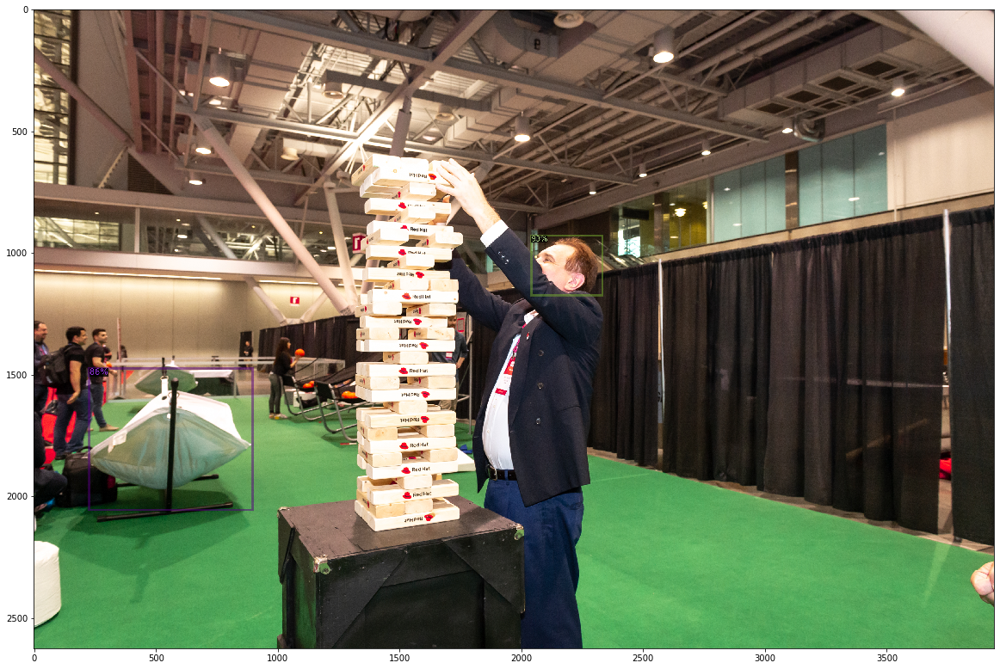

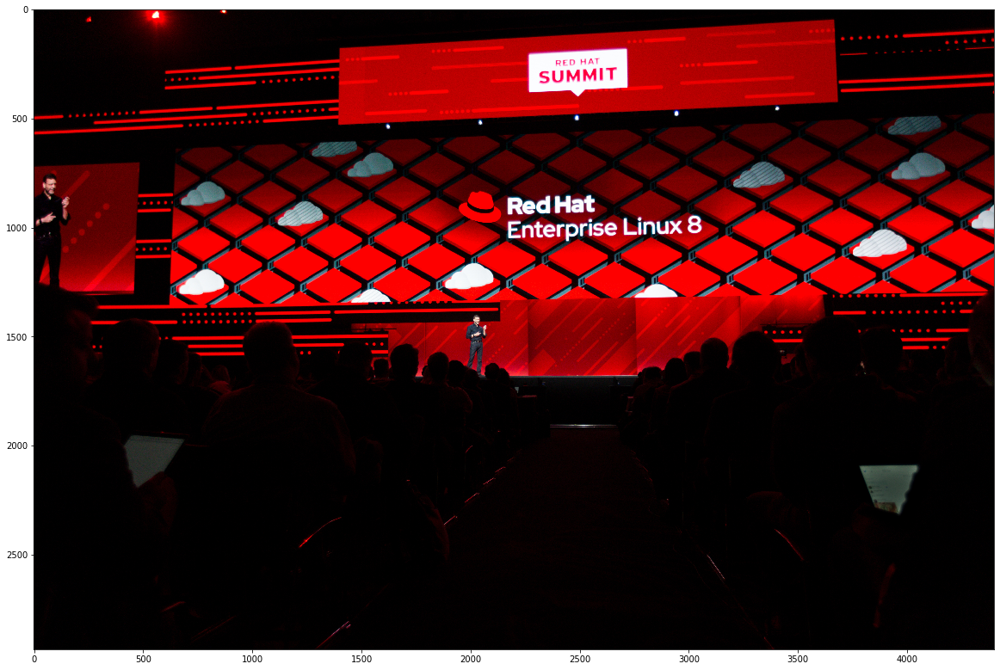

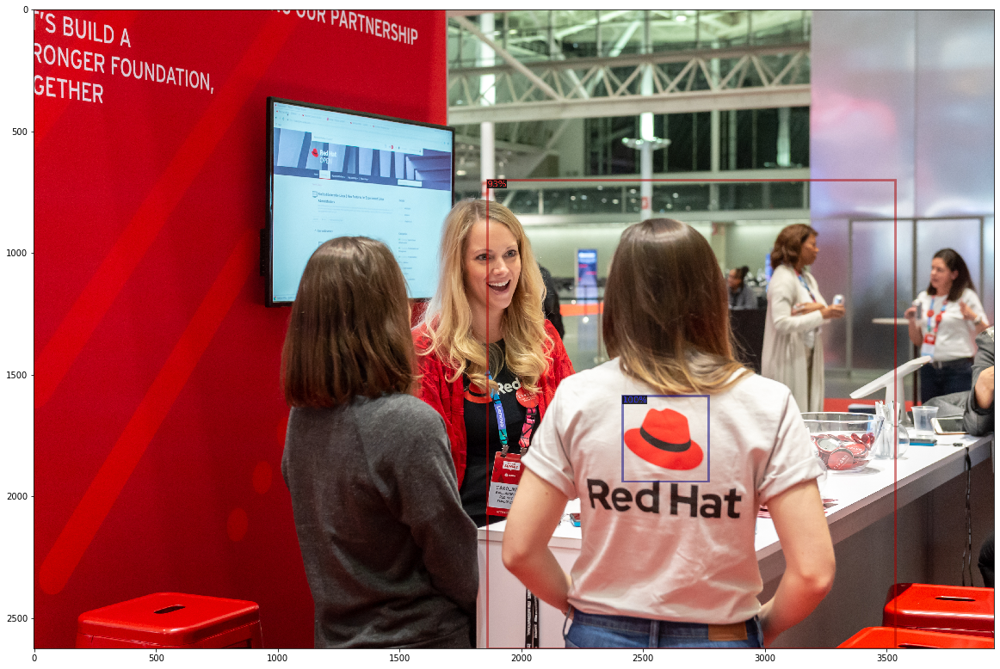

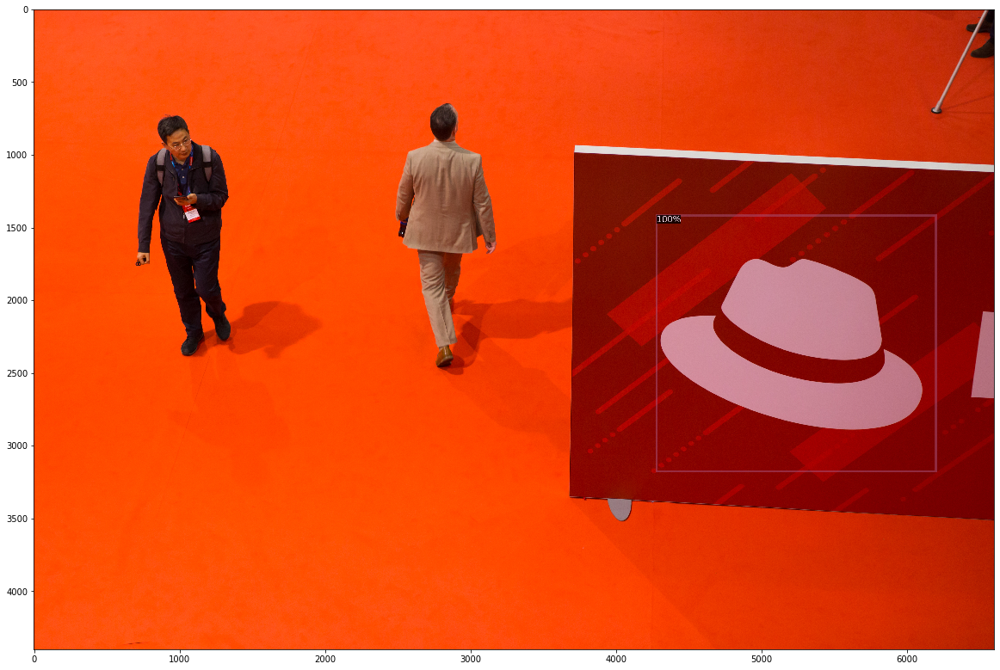

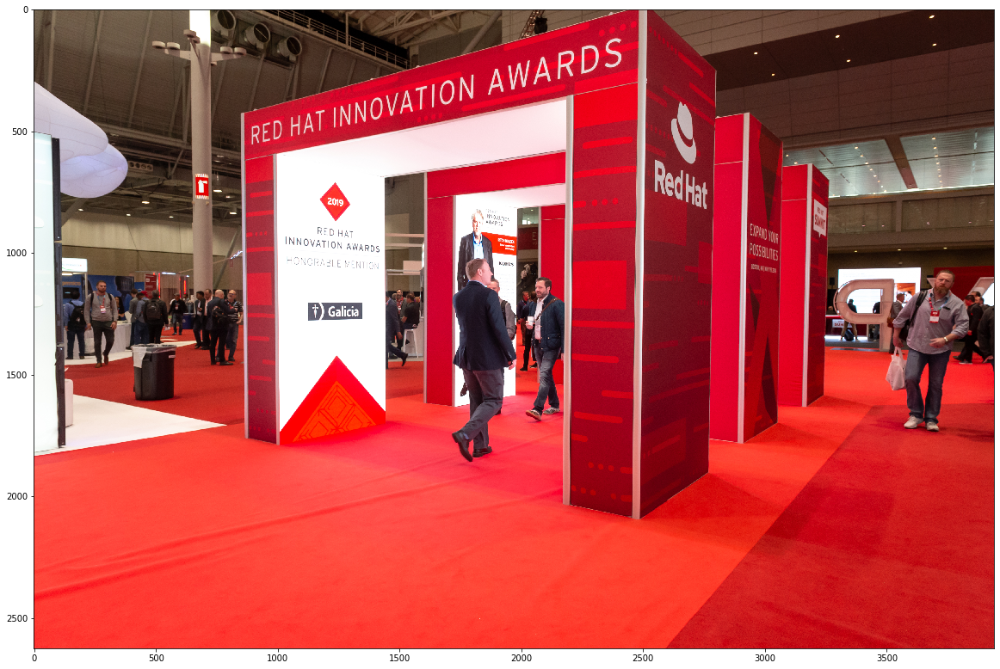

...

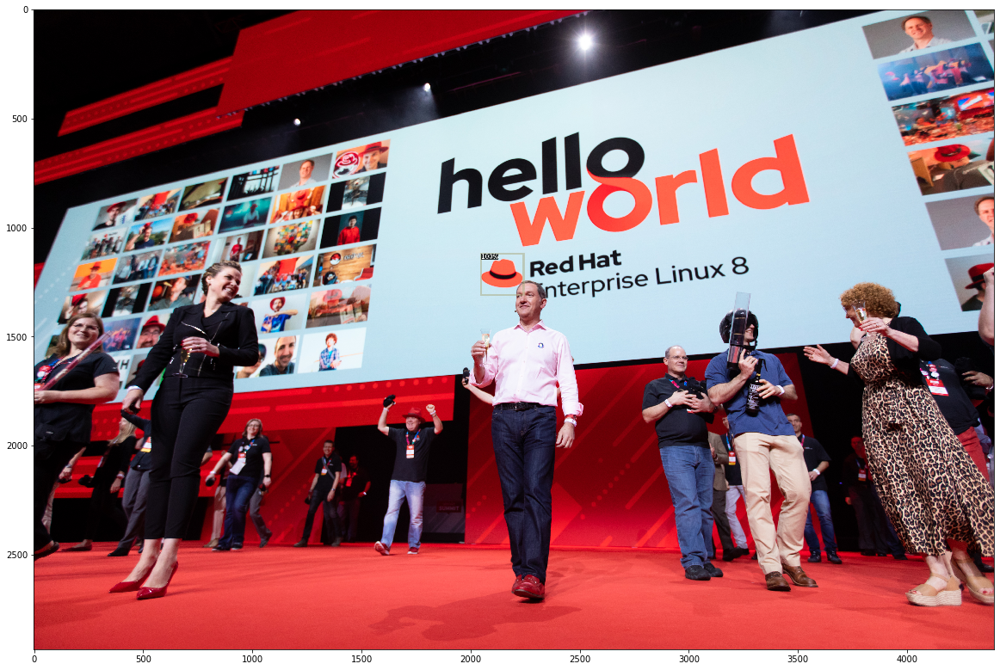

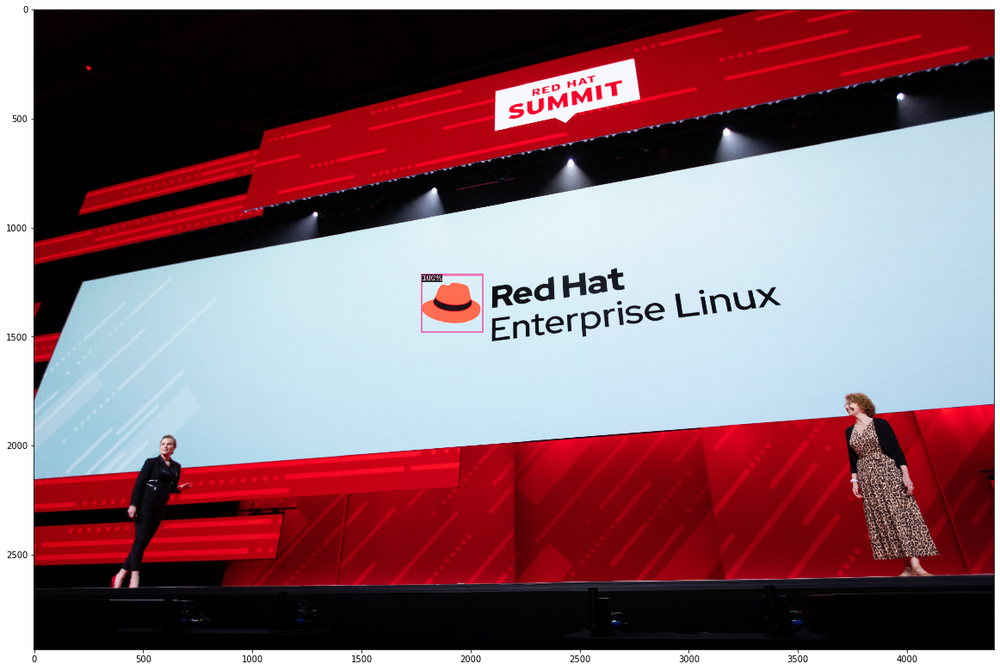

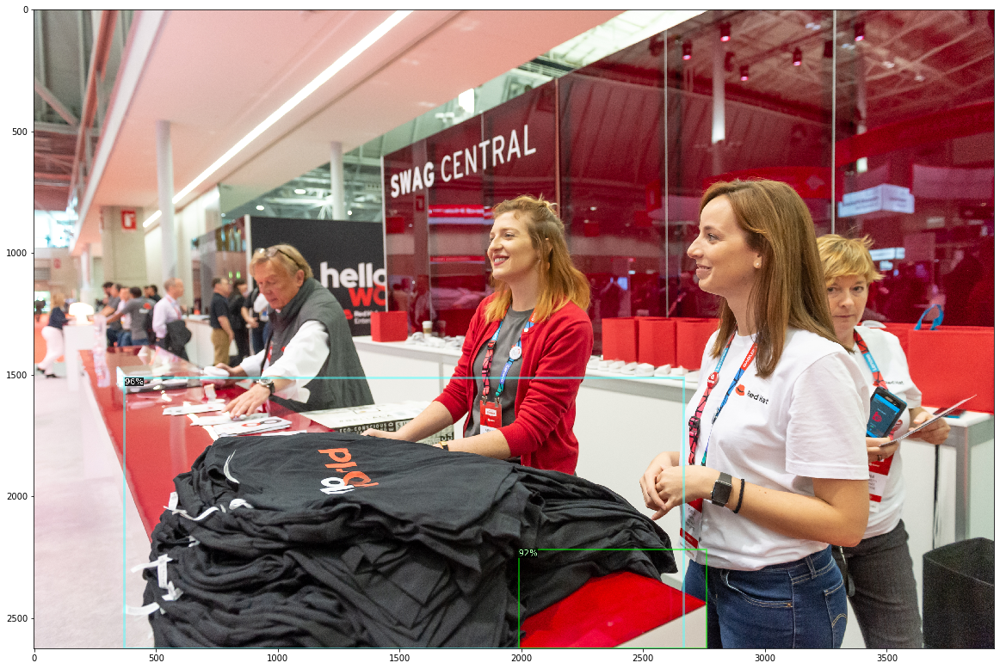

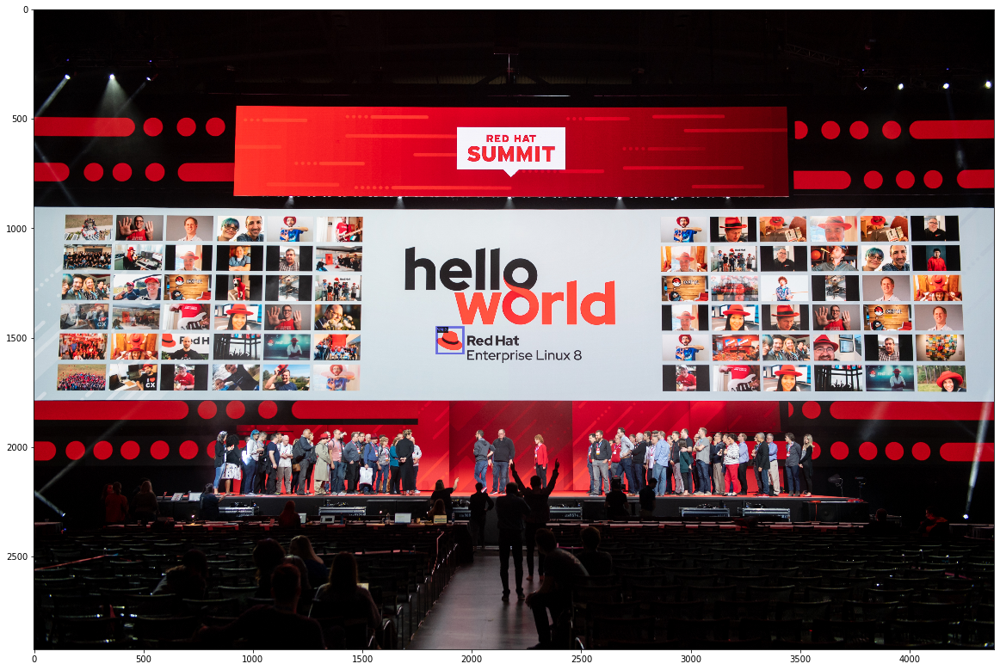

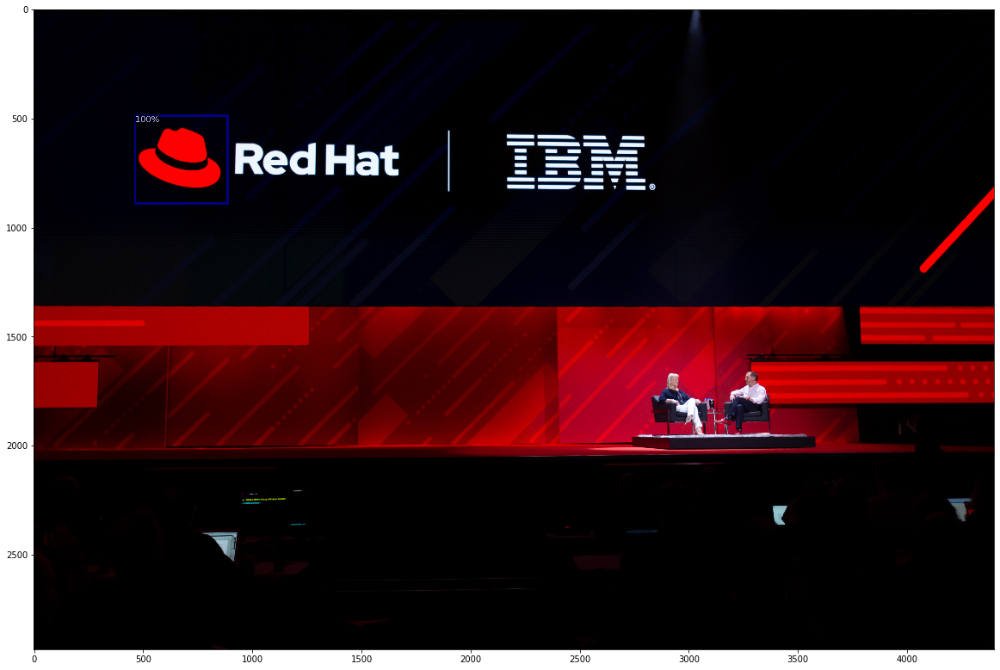

In [77]:
for img in glob.glob('rhlogo_summit_val/*'):
    plt.figure(figsize=(20,20))
    outputs = infer_img_v2(predictor, img, rhlogo_train_metadata)